# Big Data Analysis Project 2024


Group: 

- Dinis Fernandes 20221848
- Dinis Gaspar 20221869
- Inês Santos 20221916
- Luis Davila 20221949
- Sara Ferrer 20221947

In this notebook, we will explore the factors that influence Portuguese real estate prices. Our variables will be mainly about the characteristics of the properties, and we will not regard economic factors. Our ultimate goal is to be able to develop a model to accurately predict property prices.

## Disclaimer: In this notebook the big data safe functionality was not used.

Before running this notebook, it is needed to install the packages 'lightning' in the cluster that will be used.

Please run with this cluster definition: Standard 12.2 LST (Scala 2.12, Spark 3.3.2).

## Imports

In [0]:
from pyspark.sql import functions as f
from pyspark.sql.functions import *
from pyspark.sql.types import IntegerType, StringType, BooleanType, DoubleType

from pyspark.sql.functions import monotonically_increasing_id

from pyspark.ml.stat import Correlation

from pyspark.ml.feature import (
    StringIndexer,
    VectorAssembler,
    OneHotEncoder,
    StandardScaler,
)
from pyspark.ml.regression import RandomForestRegressor, LinearRegression, GBTRegressor
from pyspark.ml.classification import RandomForestClassifier
from pyspark.ml import Pipeline
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.tuning import CrossValidator, ParamGridBuilder

import torch
from torch import optim, nn, Tensor
import torch.nn.functional as F

import pyspark.pandas as ps
import seaborn as sns
import matplotlib.pyplot as plt

from pyspark.sql.types import (
    ArrayType,
    StringType,
    IntegerType,
    LongType,
    StructType,
    StructField,
    DoubleType,
    TimestampType,
)

## The Data
The dataset choosen to perform machine learning tasks is Real Estate Listings in Portugal, https://www.kaggle.com/datasets/luvathoms/portugal-real-estate-2024?resource=download. 
##### Note: The dataset is frequently updated and the version available on kaggle may differ from the one used.

### Content
- Price : Property price (Euros €).
- District : District where property is located.
- City : City where property is located.
- Town : Town where property is located.
- Type : Property type.
- EnergyCertificate : Property energy efficiency rating.
- Floor : Floor where property is located.
- Lift : True if the property has a lift, False otherwise.
- Parking : Number of parking spaces.
- HasParking : True if the property has parking, False otherwise.
- ConstructionYear : The year when the property was built.
- TotalArea : Property total area (square meters).
- GrossArea : Property gross floor area (square meters).
- PublishDate : Date when the listing was published.
- Garage : True if the property has a garage, False otherwise.
- Elevator : True if the property has an elevator, False otherwise.
- ElectricCarsCharging : True if the property has electric charging station, False otherwise.
- TotalRooms : Number of total rooms.
- NumberOfBedrooms : Number of bedrooms.
- NumberOfWC : Number of WC's.
- ConservationStatus : Property condition.
- LivingArea : Usable living area (square meters).
- LotSize : Land/Lot size (square meters).
- BuiltArea : Total constructed are of property (square meters).
- NumberOfBathrooms : Number of bathrooms.





In [0]:
# Load the dataset into a Spark DataFrame
file_location = "/FileStore/tables/portugal_listings.csv"

schema_data = StructType(
    [
        StructField("Price", DoubleType(), nullable=True),
        StructField("District", StringType(), nullable=True),
        StructField("City", StringType(), nullable=True),
        StructField("Town", StringType(), nullable=True),
        StructField("Type", StringType(), nullable=True),
        StructField("EnergyCertificate", StringType(), nullable=True),
        StructField("Floor", StringType(), nullable=True),
        StructField("Lift", BooleanType(), nullable=True),
        StructField("Parking", DoubleType(), nullable=True),
        StructField("HasParking", BooleanType(), nullable=True),
        StructField("ConstructionYear", DoubleType(), nullable=True),
        StructField("TotalArea", DoubleType(), nullable=True),
        StructField("GrossArea", DoubleType(), nullable=True),
        StructField("PublishDate", TimestampType(), nullable=True),
        StructField("Garage", BooleanType(), nullable=True),
        StructField("Elevator", BooleanType(), nullable=True),
        StructField("ElectricCarsCharging", BooleanType(), nullable=True),
        StructField("TotalRooms", DoubleType(), nullable=True),
        StructField("NumberOfBedrooms", DoubleType(), nullable=True),
        StructField("NumberOfWC", DoubleType(), nullable=True),
        StructField("ConservationStatus", StringType(), nullable=True),
        StructField("LivingArea", DoubleType(), nullable=True),
        StructField("LotSize", DoubleType(), nullable=True),
        StructField("BuiltArea", DoubleType(), nullable=True),
        StructField("NumberOfBathrooms", DoubleType(), nullable=True),
    ]
)

# Import data
pt_housing = spark.read.load(
    file_location, format="csv", sep=",", header="true", schema=schema_data
).cache()

In [0]:
# Checking data
display(pt_housing)
# Checking number of total rows
display(pt_housing.count())

Price,District,City,Town,Type,EnergyCertificate,Floor,Lift,Parking,HasParking,ConstructionYear,TotalArea,GrossArea,PublishDate,Garage,Elevator,ElectricCarsCharging,TotalRooms,NumberOfBedrooms,NumberOfWC,ConservationStatus,LivingArea,LotSize,BuiltArea,NumberOfBathrooms
250000.0,Faro,São Brás de Alportel,São Brás de Alportel,Apartment,A+,2nd Floor,true,1.0,true,null,114.0,null,null,null,null,null,2.0,null,null,null,114.0,null,null,2.0
9500.0,Faro,Albufeira,Albufeira e Olhos de Água,Apartment,NC,1st Floor,true,0.0,false,1990.0,27.0,null,null,null,null,null,0.0,null,null,null,27.0,null,null,1.0
580000.0,Faro,Vila do Bispo,Budens,Apartment,D,3rd Floor,false,1.0,true,2003.0,84.0,null,null,null,null,null,2.0,null,null,null,84.0,null,null,2.0
350000.0,Faro,Portimão,Portimão,Apartment,C,4th Floor,true,0.0,false,1985.0,68.0,null,null,null,null,null,2.0,null,null,null,68.0,null,null,1.0
175000.0,Faro,Faro,Faro (Sé e São Pedro),House,NC,null,false,0.0,false,1950.0,78.0,null,null,null,null,null,4.0,null,null,null,78.0,null,null,2.0
1485000.0,Faro,Loulé,Quarteira,House,D,Ground Floor,false,2.0,true,2004.0,472.0,null,null,null,null,null,4.0,null,null,null,414.0,null,null,5.0
1500000.0,Faro,Faro,Faro (Sé e São Pedro),Apartment,A,5th Floor,true,3.0,true,2018.0,421.0,313.0,null,null,null,null,7.0,null,null,null,262.0,null,null,null
25000.0,Faro,Portimão,Portimão,Garage,NC,Basement Level,true,1.0,true,1982.0,15.0,null,null,null,null,null,0.0,null,null,null,15.0,null,null,0.0
260000.0,Faro,Lagos,São Gonçalo de Lagos,Apartment,C,2nd Floor,false,0.0,false,1999.0,105.0,114.0,null,null,null,null,2.0,null,null,null,105.0,null,null,2.0
235000.0,Faro,Faro,Faro (Sé e São Pedro),House,NC,null,false,0.0,false,null,63.0,null,null,null,null,null,1.0,null,null,null,63.0,null,null,2.0


114623

## Explanatory Data Analysis (EDA)

In [0]:
# Check values in columns
pt_housing.select(pt_housing.columns[:5]).show(3)

pt_housing.select(pt_housing.columns[5:10]).show(3)

pt_housing.select(pt_housing.columns[10:15]).show(3)

pt_housing.select(pt_housing.columns[15:20]).show(3)

pt_housing.select(pt_housing.columns[20:]).show(3)

+--------+--------+--------------------+--------------------+---------+
|   Price|District|                City|                Town|     Type|
+--------+--------+--------------------+--------------------+---------+
|250000.0|    Faro|São Brás de Alportel|São Brás de Alportel|Apartment|
|  9500.0|    Faro|           Albufeira|Albufeira e Olhos...|Apartment|
|580000.0|    Faro|       Vila do Bispo|              Budens|Apartment|
+--------+--------+--------------------+--------------------+---------+
only showing top 3 rows

+-----------------+---------+-----+-------+----------+
|EnergyCertificate|    Floor| Lift|Parking|HasParking|
+-----------------+---------+-----+-------+----------+
|               A+|2nd Floor| true|    1.0|      true|
|               NC|1st Floor| true|    0.0|     false|
|                D|3rd Floor|false|    1.0|      true|
+-----------------+---------+-----+-------+----------+
only showing top 3 rows

+----------------+---------+---------+-----------+------+
|Co

### Summary Statistics

In [0]:
# Check column statistics
pt_housing.select(pt_housing.columns[:5]).describe().show()

pt_housing.select(pt_housing.columns[5:12]).describe().show()

pt_housing.select(pt_housing.columns[12:21]).describe().show()

pt_housing.select(pt_housing.columns[21:]).describe().show()

+-------+------------------+--------+--------+--------------------+---------+
|summary|             Price|District|    City|                Town|     Type|
+-------+------------------+--------+--------+--------------------+---------+
|  count|            114379|  114623|  114623|              114623|   114623|
|   mean| 366608.1424267567|    null|    null|                null|     null|
| stddev|4128281.7644161275|    null|    null|                null|     null|
|    min|             100.0|  Aveiro|Abrantes|A dos Cunhados e ...|Apartment|
|    max|            1.38E9|   Évora|  Óbidos|   Évora de Alcobaça|     null|
+-------+------------------+--------+--------+--------------------+---------+

+-------+-----------------+---------+------------------+------------------+--------------------+
|summary|EnergyCertificate|    Floor|           Parking|  ConstructionYear|           TotalArea|
+-------+-----------------+---------+------------------+------------------+--------------------+
|  cou

With the previous analysis we can understand that all of these variables have missing values. We can also recognize that some variables have outliers, namely GrossArea , Living Area, LotSize, BuiltArea and NumberOfBathrooms as the minimum value, the mean and the maximum values, are very distant from each other. We also have confirmation regarding this observation by analysing the standard deviation of this columns. We also acknowledge that the variables have wrong values as it does not make sense to have for example a negative value of GrossArea, NumberOfWc, BuiltArea or NumberOfBathrooms. It also does not make sense to have a 0 values for Lot Size. All of these takeaways will be further analysed and taken care of, if necessary.

For the columns: Lift, HasParking, PublishDate, Garage, Elevator, ElectricCarsCharging, .describe() does not work because this method only handles numeric and string columns. PublishDate is Timestamp and the others are Boolean.

### Value Counts of Categorical Variables

In [0]:
# For each column in the for loop we get the value counts for each possible value, as well as the number of unique values
for c in pt_housing.schema.fields:
    if isinstance(c.dataType, StringType):
        print(c.name)
        print(
            "Number of Unique Values: ",
            len(pt_housing.select(c.name).distinct().rdd.map(lambda r: r[0]).collect()),
        )
        # Transform to rdd to be able to use map and collect
        # Map is being use to flatten into a list of values
        # Collect brings values of rdd to local machine
        # Getting the count for each unique value
        display(pt_housing.groupBy(c.name).count())
        # Total number of unique values
    elif isinstance(c.dataType, BooleanType):
        print(c.name)
        print(
            "Number of Unique Values: ",
            len(pt_housing.select(c.name).distinct().rdd.map(lambda r: r[0]).collect()),
        )
        # Getting the count for each unique value
        # (same process as above)
        display(pt_housing.groupBy(c.name).count())
        # Total numer of unique values

District
Number of Unique Values:  25


District,count
Braga,9924
Aveiro,6412
Leiria,6457
Ilha da Madeira,16
Viana do Castelo,3311
Ilha de Santa Maria,235
Santarém,6135
Évora,2105
Castelo Branco,4648
Guarda,1361


Databricks visualization. Run in Databricks to view.

City
Number of Unique Values:  272


City,count
Fronteira,62
Benavente,360
Pombal,932
Batalha,156
Trancoso,70
Cartaxo,427
Tavira,499
Rio Maior,240
Albufeira,1502
Almeida,65


Databricks visualization. Run in Databricks to view.

Town
Number of Unique Values:  2238


Town,count
Sepins e Bolho,15
Aldão,42
Fermentelos,69
Cumieira,13
Espite,4
Carregueira,23
Fronteira,41
São Gião,2
Meca,19
Rapoula do Côa,2


Databricks visualization. Run in Databricks to view.

Type
Number of Unique Values:  22


Type,count
Apartment,37558
Farm,3547
Manor,6
Office,628
Studio,81
Mansion,30
Other - Residential,547
Transfer of lease,1416
Other - Commercial,714
Land,28649


Databricks visualization. Run in Databricks to view.

EnergyCertificate
Number of Unique Values:  13


EnergyCertificate,count
Not available,18
F,6429
E,9084
B,3670
NC,52691
D,12913
C,13547
A,8414
G,412
A+,3662


Databricks visualization. Run in Databricks to view.

Floor
Number of Unique Values:  20


Floor,count
5th Floor,1154
2nd Floor,5019
6th Floor,655
Attic,10
4th Floor,1902
Service Floor,14
Basement Level,750
9th Floor,167
7th Floor,425
Basement,89


Databricks visualization. Run in Databricks to view.

Lift
Number of Unique Values:  3


Lift,count
null,46408
true,17139
false,51076


Databricks visualization. Run in Databricks to view.

HasParking
Number of Unique Values:  3


HasParking,count
null,46408
true,30845
false,37370


Databricks visualization. Run in Databricks to view.

Garage
Number of Unique Values:  3


Garage,count
null,68247
true,7818
false,38558


Databricks visualization. Run in Databricks to view.

Elevator
Number of Unique Values:  3


Elevator,count
null,68247
true,10529
false,35847


Databricks visualization. Run in Databricks to view.

ElectricCarsCharging
Number of Unique Values:  3


ElectricCarsCharging,count
null,68247
true,4324
false,42052


Databricks visualization. Run in Databricks to view.

ConservationStatus
Number of Unique Values:  7


ConservationStatus,count
null,101542
Used,1531
Good condition,3468
Like new,1666
Reasonable,500
New,4641
Needs renovation,1275


Databricks visualization. Run in Databricks to view.

In the previous cell we checked the unique values in order to have better insights, for the categorical variables.

 We started with the **District** where we have 25 unique values, and we also discovered that we had a residual amount of data that does not belong to Portugal and will then be dropped. Also as expected the district with more listings is Lisbon.


 Then with **City** and **Town** where we decided to make a wordcloud for better visualization of the ocurrence of each locality. For each variable we have 272 and 2238 unique values for these variables, respectively.

 For **Type** we discovered that the most amount of listings is for Apartment types. For this variable we have 22 values.

 In the variable **Energy certificate** we could not take specific conclusions as the main category meant no certificate,  we could also understand that in this variable we had several categories that where different but meant the same. 

 Similarly in the **Floor** and **Conservation Status** variable the strongest category was about null values, so no conclusion could be taken.


  In all the boolean variables, namely , **Lift** , **Has Parking** , **Garage**, **Elevator** and **Eletric Cars Charging** , the prominent value was False. However in the **Has Parking** variable the difference between True or False is not very significant.


### Distribution and Box-Plot of Continuous Variables

The scale for variables with high scales is logarithmic but its only the scale, the values in the boxplot are still in the normal scale.

We namely use the logarithmic scale in the Price , TotalArea, GrossArea, LivingArea, LotSize, BuiltArea.

In [0]:
for c in pt_housing.schema.fields:  # Gives the name and datatype of the variable
    if isinstance(c.dataType, DoubleType):
        use = pt_housing.filter(col(c.name).isNotNull())
        # Filter out null values otherwise we cant analyse the visualizations
        print(c.name)
        display(use.select(c.name))

Price


Price
250000.0
9500.0
580000.0
350000.0
175000.0
1485000.0
1500000.0
25000.0
260000.0
235000.0


Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Parking


Parking
1.0
0.0
1.0
0.0
0.0
2.0
3.0
1.0
0.0
0.0


Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

ConstructionYear


ConstructionYear
1990.0
2003.0
1985.0
1950.0
2004.0
2018.0
1982.0
1999.0
2022.0
1998.0


Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

TotalArea


TotalArea
114.0
27.0
84.0
68.0
78.0
472.0
421.0
15.0
105.0
63.0


Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

GrossArea


GrossArea
313.0
114.0
0.0
112.0
185.0
110.0
200.0
465.0
48.0
96.0


Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

TotalRooms


TotalRooms
2.0
0.0
2.0
2.0
4.0
4.0
7.0
0.0
2.0
1.0


Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

NumberOfBedrooms


NumberOfBedrooms
17.0
2.0
2.0
4.0
2.0
0.0
2.0
4.0
2.0
3.0


Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

NumberOfWC


NumberOfWC
1.0
0.0
1.0
0.0
0.0
1.0
0.0
2.0
0.0
0.0


Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

LivingArea


LivingArea
114.0
27.0
84.0
68.0
78.0
414.0
262.0
15.0
105.0
63.0


Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

LotSize


LotSize
15907.0
5982.0
950.0
328.0
122.0
1596.0
600.0
315.0
2000.0
3540.0


Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

BuiltArea


BuiltArea
969.0
336.0
96.4
197.0
112.0
265.0
140.0
217.46
223.3
137.0


Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

NumberOfBathrooms


NumberOfBathrooms
2.0
1.0
2.0
1.0
2.0
5.0
0.0
2.0
2.0
1.0


Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

In the previous boxplots and histograms the most important takeaway is that all of our variables, have outliers that will be further analysed and  treated in the next sections.

### Outliers

#### Checking outliers in specific variables:

Here we will check data coherency and outliers by applying specific conditions

- Parking:

In [0]:
display(pt_housing.filter((col("Parking") == 0) & (col("HasParking") == "true")))
# Checking if there are rows where HasParking is true but doesnt have any available parking spots

Price,District,City,Town,Type,EnergyCertificate,Floor,Lift,Parking,HasParking,ConstructionYear,TotalArea,GrossArea,PublishDate,Garage,Elevator,ElectricCarsCharging,TotalRooms,NumberOfBedrooms,NumberOfWC,ConservationStatus,LivingArea,LotSize,BuiltArea,NumberOfBathrooms


Here we checked if there was any row where it stated if Parking was equal to 0 but the boolean variable HasParking was True. Luckly this condition was not met by any of the rows.

- TotalArea, GrossArea, LivingArea, LotSize, BuiltArea:

In [0]:
display(pt_housing.filter(((col("TotalArea") < 0) & (col("TotalArea").isNotNull()))))
# Checking if there are negative values in TotalArea

Price,District,City,Town,Type,EnergyCertificate,Floor,Lift,Parking,HasParking,ConstructionYear,TotalArea,GrossArea,PublishDate,Garage,Elevator,ElectricCarsCharging,TotalRooms,NumberOfBedrooms,NumberOfWC,ConservationStatus,LivingArea,LotSize,BuiltArea,NumberOfBathrooms
1750000.0,Aveiro,Aveiro,Glória e Vera Cruz,Apartment,A+,5th Floor,true,3.0,true,null,-271.0,271.0,null,null,null,null,3.0,null,null,null,191.0,null,null,4.0
1200000.0,Aveiro,Aveiro,Glória e Vera Cruz,Apartment,A+,4th Floor,true,3.0,true,null,-235.0,235.0,null,null,null,null,4.0,null,null,null,205.0,null,null,4.0
1180000.0,Aveiro,Aveiro,Glória e Vera Cruz,Apartment,A+,3rd Floor,true,3.0,true,null,-235.0,235.0,null,null,null,null,4.0,null,null,null,205.0,null,null,4.0
1200000.0,Aveiro,Aveiro,Glória e Vera Cruz,Apartment,A+,null,null,1.0,null,2024.0,-235.0,null,2024-06-21T12:38:12.177+0000,false,true,true,5.0,4.0,4.0,null,205.0,null,235.98,4.0
1180000.0,Aveiro,Aveiro,Glória e Vera Cruz,Apartment,A+,null,null,1.0,null,2024.0,-235.0,null,null,false,true,true,5.0,4.0,4.0,null,205.0,null,235.98,4.0
1750000.0,Aveiro,Aveiro,Glória e Vera Cruz,Apartment,A+,null,null,1.0,null,2024.0,-271.0,null,2024-06-21T13:04:31.297+0000,false,true,true,4.0,3.0,4.0,null,191.0,null,271.2,4.0
960000.0,Braga,Amares,"Caldelas, Sequeiros e Paranhos",Farm,NC,null,null,1.0,null,null,-7196067.0,null,null,false,false,false,null,null,0.0,null,71960.0,71960.0,null,0.0


Here we checked if we had any property where the TotalArea appeared as a negative value and filtered according to it. This condition was met by 7 rows.

In [0]:
display(pt_housing.filter(((col('GrossArea')<0)&(col('GrossArea').isNotNull()))))
# Checking if there are negative values in GrossArea

Price,District,City,Town,Type,EnergyCertificate,Floor,Lift,Parking,HasParking,ConstructionYear,TotalArea,GrossArea,PublishDate,Garage,Elevator,ElectricCarsCharging,TotalRooms,NumberOfBedrooms,NumberOfWC,ConservationStatus,LivingArea,LotSize,BuiltArea,NumberOfBathrooms
87000.0,Setúbal,Setúbal,São Sebastião,Apartment,C,2nd Floor,true,0.0,false,1980.0,69.0,-1.0,null,null,null,null,2.0,null,null,null,69.0,null,null,1.0
238000.0,Setúbal,Almada,Costa de Caparica,Apartment,C,1st Floor,false,0.0,false,1972.0,54.0,-7.0,null,null,null,null,1.0,null,null,null,46.0,null,null,1.0


Here we repeated the process for GrossArea and the condition was met by 2 rows.

In [0]:
display(pt_housing.filter(((col("LivingArea") < 0) & (col("LivingArea").isNotNull()))))
# Checking if there are negative values in LivingArea

Price,District,City,Town,Type,EnergyCertificate,Floor,Lift,Parking,HasParking,ConstructionYear,TotalArea,GrossArea,PublishDate,Garage,Elevator,ElectricCarsCharging,TotalRooms,NumberOfBedrooms,NumberOfWC,ConservationStatus,LivingArea,LotSize,BuiltArea,NumberOfBathrooms


In the LivingArea there are no rows with negative values.

In [0]:
display(pt_housing.filter(((col("LotSize") < 0) & (col("LotSize").isNotNull()))))
# Checking if there are negative values in LotSize

Price,District,City,Town,Type,EnergyCertificate,Floor,Lift,Parking,HasParking,ConstructionYear,TotalArea,GrossArea,PublishDate,Garage,Elevator,ElectricCarsCharging,TotalRooms,NumberOfBedrooms,NumberOfWC,ConservationStatus,LivingArea,LotSize,BuiltArea,NumberOfBathrooms


In LotSize we also have no rows with negative values.

In [0]:
display(pt_housing.filter(((col("BuiltArea") < 0) & (col("BuiltArea").isNotNull()))))
# Checking if there are negative values in BuiltArea

Price,District,City,Town,Type,EnergyCertificate,Floor,Lift,Parking,HasParking,ConstructionYear,TotalArea,GrossArea,PublishDate,Garage,Elevator,ElectricCarsCharging,TotalRooms,NumberOfBedrooms,NumberOfWC,ConservationStatus,LivingArea,LotSize,BuiltArea,NumberOfBathrooms
87000.0,Setúbal,Setúbal,São Sebastião,Apartment,C,null,null,0.0,null,1980.0,69.0,null,null,false,true,false,null,2.0,0.0,null,69.0,null,-1.0,1.0


And, once again, there are no negative rows in BuiltArea.

- TotalRooms:

In [0]:
display(
    pt_housing.filter(
        (col("TotalRooms") == 0)
        & (col("NumberOfBedrooms") != 0)
        & (col("NumberOfBedrooms").isNotNull())
    )
)
# Checking if there are rows where TotalRooms is 0 although the NumberOfBedrooms is not

Price,District,City,Town,Type,EnergyCertificate,Floor,Lift,Parking,HasParking,ConstructionYear,TotalArea,GrossArea,PublishDate,Garage,Elevator,ElectricCarsCharging,TotalRooms,NumberOfBedrooms,NumberOfWC,ConservationStatus,LivingArea,LotSize,BuiltArea,NumberOfBathrooms
129990.0,Aveiro,Santa Maria da Feira,Rio Meão,Apartment,D,null,null,1.0,null,2006.0,87.0,null,null,false,true,false,0.0,2.0,1.0,Used,87.0,102.0,102.0,1.0
29000.0,Aveiro,Vale de Cambra,Arões,House,NC,null,null,1.0,null,1937.0,56.0,null,null,false,false,false,0.0,2.0,0.0,Needs renovation,159.0,238.0,103.0,0.0
360000.0,Aveiro,Albergaria-a-Velha,Albergaria-a-Velha e Valmaior,Apartment,A,null,null,1.0,null,2022.0,140.0,null,null,false,true,false,0.0,3.0,0.0,null,140.0,170.0,null,0.0
27000.0,Beja,Odemira,Relíquias,House,NC,null,null,0.0,null,1949.0,95.0,null,2024-07-02T11:19:14.450+0000,false,false,false,0.0,3.0,0.0,Needs renovation,0.0,95.0,95.0,2.0
59000.0,Braga,Vila Verde,Coucieiro,Land,NC,null,null,0.0,null,1900.0,729.0,null,2024-05-23T08:43:58.537+0000,false,false,false,0.0,3.0,3.0,New,729.0,729.0,null,3.0
159500.0,Braga,Vila Verde,Coucieiro,House,NC,null,null,0.0,null,1900.0,729.0,null,2024-02-21T17:47:54.767+0000,false,false,false,0.0,3.0,3.0,New,729.0,729.0,null,3.0
90000.0,Braga,Braga,Lomar e Arcos,Land,NC,null,null,0.0,null,null,546.0,null,null,false,false,false,0.0,3.0,0.0,New,null,546.0,546.0,0.0
23650.0,Castelo Branco,Fundão,"Fundão, Valverde, Donas, Aldeia de Joanes e Aldeia Nova do Cabo",House,NC,null,null,0.0,null,1980.0,403.0,null,null,true,false,false,0.0,1.0,0.0,New,403.0,403.0,null,0.0
998000.0,Évora,Évora,"Évora (São Mamede, Sé, São Pedro e Santo Antão)",Building,E,null,null,1.0,null,1990.0,293.0,null,null,false,false,false,0.0,5.0,3.0,Like new,293.0,475.0,293.0,3.0
289900.0,Faro,Silves,São Bartolomeu de Messines,House,D,null,null,0.0,null,2015.0,140.0,null,null,true,false,false,0.0,3.0,0.0,Like new,140.0,null,null,4.0


Here we check if there are any rows the TotalRooms stated are 0 but the number of bedrooms is different from 0. This inconsistency was found in 33 rows.

In [0]:
display(pt_housing.filter((col("TotalRooms") > 10)))
# Checking for more than 10 TotalRooms

Price,District,City,Town,Type,EnergyCertificate,Floor,Lift,Parking,HasParking,ConstructionYear,TotalArea,GrossArea,PublishDate,Garage,Elevator,ElectricCarsCharging,TotalRooms,NumberOfBedrooms,NumberOfWC,ConservationStatus,LivingArea,LotSize,BuiltArea,NumberOfBathrooms
900000.0,Faro,Loulé,Almancil,Farm,NC,null,false,3.0,true,null,3327.0,null,null,null,null,null,12.0,null,null,null,297.0,null,null,0.0
960000.0,Faro,Portimão,Portimão,Building,F,null,false,3.0,true,1951.0,996.0,null,null,null,null,null,12.0,null,null,null,996.0,null,null,6.0
975000.0,Faro,Lagoa (Algarve),Estômbar e Parchal,House,D,null,false,1.0,true,1951.0,530.0,null,null,null,null,null,11.0,null,null,null,441.0,null,null,10.0
1400000.0,Faro,Lagoa (Algarve),Lagoa e Carvoeiro,House,D,null,false,2.0,true,1965.0,1564.0,null,null,null,null,null,13.0,null,null,null,344.0,null,null,4.0
1250000.0,Guarda,Guarda,Guarda,Hotel,NC,null,false,0.0,false,1998.0,1383.0,1869.0,null,null,null,null,21.0,null,null,null,1383.0,null,null,0.0
1260000.0,Faro,Olhão,Pechão,Other - Residential,E,Ground Floor,false,3.0,true,2018.0,8000.0,null,null,null,null,null,11.0,null,null,null,null,null,null,10.0
9000000.0,Faro,Lagos,Luz,Hotel,D,null,false,3.0,true,2009.0,30000.0,27000.0,null,null,null,null,21.0,null,null,null,27000.0,null,null,0.0
4300000.0,Faro,Albufeira,Guia,Farm,F,null,false,3.0,true,1930.0,76250.0,null,null,null,null,null,15.0,null,null,null,596.0,null,null,null
1390000.0,Faro,Monchique,Monchique,Building,C,null,false,0.0,false,1974.0,785.0,null,null,null,null,null,21.0,null,null,null,917.0,null,null,null
2799000.0,Faro,Loulé,Quarteira,Hotel,D,null,false,0.0,false,null,352.0,528.0,null,null,null,null,17.0,null,null,null,null,null,null,0.0


We decided to check every property that had more than 10 rooms, as it's strange if that happens in an apartment. We found 944 rows which is a high number, but relatively normal, as we also have buildings and hotels in the listings.

- NumberOfBedrooms:

In [0]:
display(
    pt_housing.filter(
        (col("NumberOfBedrooms").isNotNull()) & (col("NumberOfBedrooms") > 10)
    )
)
# Checking for more than 10 NumberOfBedrooms

Price,District,City,Town,Type,EnergyCertificate,Floor,Lift,Parking,HasParking,ConstructionYear,TotalArea,GrossArea,PublishDate,Garage,Elevator,ElectricCarsCharging,TotalRooms,NumberOfBedrooms,NumberOfWC,ConservationStatus,LivingArea,LotSize,BuiltArea,NumberOfBathrooms
299900.0,Aveiro,Águeda,Valongo do Vouga,Farm,NC,null,null,0.0,null,1951.0,446.0,null,2024-10-21T16:42:32.017+0000,false,false,false,17.0,17.0,1.0,null,446.0,15907.0,969.0,1.0
3000000.0,Aveiro,Santa Maria da Feira,"Santa Maria da Feira, Travanca, Sanfins e Espargo",Hotel,A,null,null,0.0,null,2017.0,1280.0,null,2024-10-08T14:38:21.017+0000,false,true,false,null,15.0,3.0,Like new,1280.0,1010.0,1280.0,15.0
199000.0,Aveiro,Sever do Vouga,Silva Escura e Dornelas,House,F,null,null,1.0,null,1951.0,862.0,null,null,false,false,false,null,12.0,0.0,Reasonable,529.0,862.0,null,1.0
220000.0,Aveiro,Aveiro,Aradas,House,NC,null,null,0.0,null,1950.0,134.0,null,null,false,false,false,12.0,12.0,0.0,null,134.0,1064.0,null,0.0
1650000.0,Aveiro,Oliveira de Azeméis,"Oliveira de Azeméis, Santiago de Riba-Ul, Ul, Macinhata da Seixa e Madail",Building,C,null,null,1.0,null,2002.0,1940.0,null,null,false,false,false,null,14.0,0.0,Needs renovation,1940.0,2850.0,null,0.0
1650000.0,Aveiro,Oliveira de Azeméis,"Oliveira de Azeméis, Santiago de Riba-Ul, Ul, Macinhata da Seixa e Madail",Farm,C,null,null,0.0,null,null,5178.0,null,null,false,false,false,15.0,14.0,0.0,null,null,5178.0,5178.0,0.0
3500000.0,Aveiro,Águeda,Fermentelos,Building,NC,null,null,1.0,null,1990.0,1126.0,null,null,false,true,false,43.0,21.0,0.0,null,1126.0,700.0,1464.0,42.0
2250000.0,Aveiro,Ovar,"Ovar, São João, Arada e São Vicente de Pereira Jusã",Hotel,NC,null,null,0.0,null,1990.0,3750.0,null,null,true,true,false,null,21.0,1.0,null,3750.0,2192.0,1667.0,61.0
320000.0,Beja,Beja,Beja (Salvador e Santa Maria da Feira),House,D,null,null,0.0,null,1975.0,298.0,null,2024-09-09T12:09:54.663+0000,false,false,false,18.0,14.0,0.0,null,49.0,647.0,null,1.0
2300000.0,Beja,Ourique,Ourique,Hotel,C,null,null,1.0,null,1985.0,900.0,null,null,false,false,false,44.0,21.0,null,Good condition,900.0,7100.0,1125.0,49.0


Here we repeted the same logic but only for the NumberOfBedrooms, and we found 196 rows. Again as we have farms, hotels, etc. it makes sense.

- NumberOfWC:

In [0]:
display(
    pt_housing.filter(
        (col("NumberOfWC").isNotNull()) & (col("NumberOfWC") > 30)
    ).select(["Type", "NumberOfWC"])
)
# Checking for more than 30 NumberOfWC in relation to the property Type

Type,NumberOfWC
Hotel,35.0
Other - Residential,40.0
Apartment,59.0
Building,40.0
Hotel,37.0


In the previous cell we decided to check by Type if there are any properties with NumberOfWc higher of 30. The only strange one, is an apartment with 59 wc's.


In [0]:
display(pt_housing.filter((col("NumberOfWC").isNotNull()) & (col("NumberOfWC") < 0)))
# Checking if there are negative values for NumberOfWC

Price,District,City,Town,Type,EnergyCertificate,Floor,Lift,Parking,HasParking,ConstructionYear,TotalArea,GrossArea,PublishDate,Garage,Elevator,ElectricCarsCharging,TotalRooms,NumberOfBedrooms,NumberOfWC,ConservationStatus,LivingArea,LotSize,BuiltArea,NumberOfBathrooms
1250000.0,Lisboa,Lisboa,Avenidas Novas,Apartment,NC,null,null,0.0,null,null,133.0,null,null,true,true,false,3.0,2.0,-15.0,New,127.0,null,null,-13.0


We decided to also check if there are any properties with a negative amount of wc's. We found only 1 row with that wrong value.

- NumberOfBathrooms:

In [0]:
display(
    pt_housing.filter(
        (col("NumberOfBathrooms").isNotNull()) & (col("NumberOfBathrooms") > 30)
    ).select(["Type", "NumberOfBathrooms"])
)
# Checking for more than 30 Bathrooms

Type,NumberOfBathrooms
Building,42.0
Hotel,61.0
Hotel,49.0
Hotel,35.0
Farm,34.0
Farm,39.0
Hotel,90.0
Other - Residential,40.0
Investment,32.0
Investment,32.0


Again we decided to check if there are any properties with NumberOfBathrooms higher than 30. Again we only found an apartment with 62 bathrooms as a strange row.

In [0]:
display(
    pt_housing.filter(
        (col("NumberOfBathrooms").isNotNull()) & (col("NumberOfBathrooms") < 0)
    )
)
# Checking if there are negative values in NumerOfBathrooms

Price,District,City,Town,Type,EnergyCertificate,Floor,Lift,Parking,HasParking,ConstructionYear,TotalArea,GrossArea,PublishDate,Garage,Elevator,ElectricCarsCharging,TotalRooms,NumberOfBedrooms,NumberOfWC,ConservationStatus,LivingArea,LotSize,BuiltArea,NumberOfBathrooms
180000.0,Leiria,Pombal,Santiago e São Simão de Litém e Albergaria dos Doze,House,B-,null,false,0.0,false,2011.0,1122.0,null,null,null,null,null,2.0,null,null,null,90.0,null,null,-1.0
1250000.0,Lisboa,Lisboa,Avenidas Novas,Apartment,NC,3rd Floor,true,2.0,true,null,133.0,null,null,null,null,null,2.0,null,null,null,127.0,null,null,-13.0
1250000.0,Lisboa,Lisboa,Avenidas Novas,Apartment,NC,null,null,0.0,null,null,133.0,null,null,true,true,false,3.0,2.0,-15.0,New,127.0,null,null,-13.0


We also checked if there any properties with a negative ammount of bathrooms, and we found 3 rows.

- Type=Land:

In [0]:
display(
    pt_housing.filter(
        (col("Type") == "Land")
        & (
            (col("TotalRooms") != 0)
            | (col("NumberOfBedrooms") != 0)
            | (col("NumberOfWC") != 0)
            | (col("NumberOfBathrooms") != 0)
            | (col("Elevator") == "true")
            | (col("Floor") != "Ground Floor")
        )
    )
)
# checking for inconsistencies when Type=Land

Price,District,City,Town,Type,EnergyCertificate,Floor,Lift,Parking,HasParking,ConstructionYear,TotalArea,GrossArea,PublishDate,Garage,Elevator,ElectricCarsCharging,TotalRooms,NumberOfBedrooms,NumberOfWC,ConservationStatus,LivingArea,LotSize,BuiltArea,NumberOfBathrooms
320000.0,Leiria,Peniche,Peniche,Land,NC,null,false,0.0,false,null,3320.0,0.0,null,null,null,null,null,null,null,null,0.0,null,null,1.0
100000.0,Faro,Alcoutim,Alcoutim e Pereiro,Land,NC,null,false,0.0,false,null,24920.0,null,null,null,null,null,null,null,null,null,null,null,null,0.0
139000.0,Faro,Loulé,Boliqueime,Land,NC,null,false,0.0,false,null,32966.0,null,null,null,null,null,null,null,null,null,null,null,null,0.0
19000.0,Faro,Lagoa (Algarve),Estômbar e Parchal,Land,NC,null,false,0.0,false,null,3710.0,3710.0,null,null,null,null,null,null,null,null,3710.0,null,null,0.0
165000.0,Faro,Castro Marim,Altura,Land,NC,null,false,3.0,true,2023.0,960.0,null,null,null,null,null,null,null,null,null,null,null,null,0.0
75000.0,Faro,Olhão,Moncarapacho e Fuseta,Land,NC,null,false,0.0,false,null,760.0,null,null,null,null,null,null,null,null,null,760.0,null,null,0.0
1.85E7,Faro,Faro,Faro (Sé e São Pedro),Land,D,null,false,0.0,false,null,45400.0,null,null,null,null,null,null,null,null,null,null,null,null,0.0
230000.0,Faro,Lagos,São Gonçalo de Lagos,Land,NC,null,false,0.0,false,null,407.0,407.0,null,null,null,null,0.0,null,null,null,200.0,null,null,0.0
890000.0,Faro,Tavira,Tavira (Santa Maria e Santiago),Land,NC,null,false,0.0,false,null,2668.0,null,null,null,null,null,null,null,null,null,null,null,null,0.0
45000.0,Faro,Vila do Bispo,Vila do Bispo e Raposeira,Land,NC,null,false,0.0,false,null,6750.0,null,null,null,null,null,null,null,null,null,null,null,null,0.0


We decided to check any inconsistencies with land such as if the number of total rooms and number of bedrrooms differs from 0, which does not make sense, and the same with number of bathrooms and wc. Also if there is an elevator, and if the land is not described as being on the ground floor.

### Handling Outliers

In this section we created limits for the data to handle the outliers. This limits where defined based on the boxplot previously made.

In [0]:
pt_housing = pt_housing.withColumn(
    "Price", when(col("Price") > 2000000, 2000000).otherwise(col("Price"))
)

In the price we limited to 2 million.

In [0]:
pt_housing = pt_housing.withColumn(
    "ConstructionYear",
    when(col("ConstructionYear") < 1918, 1918).otherwise(col("ConstructionYear")),
)

In construction everything lower than 1918 will be considered 1918.

In [0]:
pt_housing = pt_housing.withColumn(
    "TotalArea", when(col("TotalArea") > 2000000, 2000000).otherwise(col("TotalArea"))
)

In total area we also limited to 2 million.

In [0]:
pt_housing = pt_housing.withColumn(
    "GrossArea", when(col("GrossArea") > 300000, 300000).otherwise(col("GrossArea"))
)

In gross area the upper limit is 300 thousand.

In [0]:
pt_housing = pt_housing.withColumn(
    "LivingArea", when(col("LivingArea") > 60000, 60000).otherwise(col("LivingArea"))
)

In living area we decided on capping at 60 thousand.

In [0]:
pt_housing = pt_housing.withColumn(
    "LotSize", when(col("LotSize") > 18000000, 18000000).otherwise(col("LotSize"))
)

In lot size the the limit decided was 18 million.

In [0]:
pt_housing = pt_housing.withColumn(
    "BuiltArea", when(col("BuiltArea") > 250000, 250000).otherwise(col("BuiltArea"))
)

And in built area we decided to limit it to 250 thousands.

In TotalRooms we saw that sometimes we have a 0 in this column while the bedrooms, bathrooms and WC columns had values, so we decided to sum these and have the result as the value for TotalRooms.

In [0]:
pt_housing = pt_housing.withColumn(
    "TotalRooms",
    when(
        col("TotalRooms") == 0,
        coalesce(col("NumberOfBedrooms"), lit(0))
        + coalesce(col("NumberOfBathrooms"), lit(0))
        + coalesce(col("NumberOfWC"), lit(0)),
    ).otherwise(col("TotalRooms")),
)

# With coalesce we will check between the column we are specifying if there are nulls. If there are nulls we are going to use lit that (creates a column with 0) and uses that number.

# When TotalRooms = 0, we sum the values in NumberOfBedrooms, NumberOfBathrooms and NumberOfWC and assign this value to TotalRooms

# We need coalesce and lit because of the null values

For the columns in the code below, we checked that when the type of property is Land it didnt make sense to have true in garage, etc, nor in the number of bedrooms, etc, so we put them to false or 0.

In [0]:
def land_changes(data, c):

    c_type = [f.dataType for f in data.schema.fields if f.name == c][0]
    # We get the datatype for the column we are changing and as it is in a list of lists and we want to get only a simple list we index it

    # Getting the datatype for each variable

    if isinstance(c_type, BooleanType):
        # If the variable is a boolean

        data = data.withColumn(
            c,
            when(
                col("Type") == "Land",
                False,
            ).otherwise(col(c)),
        )
    # When Type=Land, change to False

    elif isinstance(c_type, DoubleType):
        # If the variable is doubletype

        data = data.withColumn(
            c,
            when(
                col("Type") == "Land",
                0,
            ).otherwise(col(c)),
        )
        # When Type=Land, change to 0

    return data


cols_change = [
    "NumberOfBedrooms",
    "TotalRooms",
    "NumberOfWC",
    "NumberOfBathrooms",
    "Elevator",
    "Garage",
    "ElectricCarsCharging",
]

for c in cols_change:
    pt_housing = land_changes(pt_housing, c)

There was an apartment with more than 2000 TotalRooms, we filtered that row out.

In [0]:
pt_housing = pt_housing.filter((col("TotalRooms") < 100) | (col("TotalRooms").isNull()))
# Filtering out rows when TotalRooms > 100

We had negative values in the NumberOfWC and an apartment with 59 WC as this also didnt make sense, we filtered these rows out.

In [0]:
pt_housing = pt_housing.filter(
    ((col("NumberOfWC") >= 0) & (col("NumberOfWC") < 40)) | (col("NumberOfWC").isNull())
)
# Filtering out rows with negative values in NumberOfWC and when NumberOfWC > 40

The NumberOfBathrooms also had negative values, so we filter those out too.

In [0]:
pt_housing = pt_housing.filter(
    (col("NumberOfBathrooms") >= 0) | (col("NumberOfBathrooms").isNull())
)
# Filtering out rows with negative values in NumberOfBathrooms

There were some special cases when the TotalRooms was negative. We checked and the absolute value made sense, so we assumed that the negative sign was a mistake.

In [0]:
pt_housing = pt_housing.withColumn(
    "TotalRooms",
    when(
        col("TotalRooms") < 0,
        abs(pt_housing.TotalRooms),
    ).otherwise(col("TotalRooms")),
)

# When TotalRooms < 0, assign the absolute value

We decided to filter out negative and rows with 0 in the area variables as this doesn't make sense.

In [0]:
def drop_0(data, c):

    data = data.filter(
        (col(c) > 0) | (col(c).isNull())
    )  # We drop the rows where the specific column is 0
    # Filtering out rows where the specified column is < 0

    return data


cols_change = ["TotalArea", "LotSize", "BuiltArea", "LivingArea", "GrossArea"]
for c in cols_change:
    pt_housing = drop_0(pt_housing, c)

Filtered out houses outside of Portugal.

In [0]:
pt_housing = pt_housing.filter((col("District") != "Z - Fora de Portugal"))
# Filtering out rows when District = Z - Fora de Portugal

In [0]:
display(100 - (((pt_housing.count()) / 114623) * 100))
# Checking percentage of dropped rows in handling
# 114623 is the original number of rows

1.5206372194062254

In the end we dropped 1,5% of our rows.

## Visualizations 

We will now obtain some interesting visualizations to give us some added context about our data.

In [0]:
avg_per_district = pt_housing.groupBy("District").mean("Price")
# Getting average price per district
avg_per_district = avg_per_district.withColumnRenamed("avg(price)", "AvgPrice")
# Renaming the column
display(avg_per_district)

District,AvgPrice
Braga,241652.6149138019
Aveiro,242561.39426691728
Leiria,214904.1524169422
Ilha da Madeira,191996.42857142858
Viana do Castelo,209645.70756149408
Ilha de Santa Maria,190042.02183406113
Santarém,174380.7457996369
Évora,292104.8561808562
Castelo Branco,94937.06780776827
Guarda,117161.9028189911


Databricks visualization. Run in Databricks to view.

As expected houses in Lisbon are the ones that are more expensive

In [0]:
avg_per_type = pt_housing.groupBy("Type").mean("Price")
# Getting average price per type of property
avg_per_type = avg_per_type.withColumnRenamed("avg(price)", "AvgPrice")
# Renaming the column
display(avg_per_type)

Type,AvgPrice
Apartment,365692.87720014236
Farm,501583.66298020957
Manor,1159166.6666666667
Office,348716.04885993485
Studio,194362.5
Mansion,1474821.4285714286
Other - Residential,164544.61254612546
Transfer of lease,115387.45664739884
Other - Commercial,448456.4449213162
Land,165410.5877035888


Databricks visualization. Run in Databricks to view.

Here we can see, that as expected, the type of property with higher average price, is the Estate

In [0]:
avg_per_EC = pt_housing.groupBy("EnergyCertificate").mean("Price")
# Getting average price per energy certificate
avg_per_EC = avg_per_EC.withColumnRenamed("avg(price)", "AvgPrice")
# Renaming the column
display(avg_per_EC)

EnergyCertificate,AvgPrice
Not available,277150.0
F,261552.9403806827
E,314129.98911335575
B,555072.8588821251
NC,223534.5208354557
D,360731.8575714511
C,392914.53212806024
A,569658.7144235407
G,288303.88753056235
A+,544390.6658527778


Databricks visualization. Run in Databricks to view.

Here unexpectely, instead of the A+ energy certificate being the one that mostly increases the price, its the A ceritifcate that has more influence.

In [0]:
avg_lift = pt_housing.groupBy("Lift").mean("Price")
# Getting average price for houses with and without a lift
avg_lift = avg_lift.withColumnRenamed("avg(price)", "AvgPrice")
# Renaming the column
display(avg_lift)

Lift,AvgPrice
null,328353.7730228271
true,415272.0116365925
false,288887.6510387523


Databricks visualization. Run in Databricks to view.

As expected, houses that have a lift are, on average, more expensive.

In [0]:
display(pt_housing.select(["Price", "TotalRooms"]))
# Checking price for number of total rooms

Price,TotalRooms
250000.0,2.0
9500.0,1.0
580000.0,2.0
350000.0,2.0
175000.0,4.0
1485000.0,4.0
1500000.0,7.0
25000.0,0.0
260000.0,2.0
235000.0,1.0


Databricks visualization. Run in Databricks to view.

Houses with 3 rooms have the highest price.

## Correlation

VectorAssembler filters out the rows with missing values, because of that we cannot have all variables to make the correlation matrix, as if we include all of them, no rows will be available. Therefore we decided to leave them out and keep only the ones we think are more relevant. However we would like to note that this is just a visualization, and the correlation matrix is being made only with 7243 rows of data, due to the high rate of missing values in our dataset.

In [0]:
# GrossArea isn't in the list
num_cols = [
    "TotalRooms",
    "Parking",
    "ConstructionYear",
    "TotalArea",
    "NumberOfBedrooms",
    "NumberOfBathrooms",
    "NumberOfWC",
    "Price",
    "BuiltArea",
]

In [0]:
assembler = VectorAssembler(
    inputCols=num_cols, outputCol="features", handleInvalid="skip"
)

df = assembler.transform(pt_housing).select("features")

In [0]:
pearson_correlation = Correlation.corr(df, "features", "pearson").collect()[0][0]
corr_matrix = pearson_correlation.toArray().tolist()
df_corr = spark.createDataFrame(corr_matrix, num_cols)

display(df_corr)

TotalRooms,Parking,ConstructionYear,TotalArea,NumberOfBedrooms,NumberOfBathrooms,NumberOfWC,Price,BuiltArea
1.0,0.06764244752236627,-0.0947656186442019,-0.018493615767445886,0.7883052781698379,0.65073464825634,0.29213218131353724,0.3410679708829423,-0.044098016166401105
0.06764244752236627,1.0,0.22472552368974683,-0.03296450916055057,0.08074652895028848,0.14112412717898262,0.07143212678065378,0.18389675263598296,-0.04785277705516369
-0.0947656186442019,0.22472552368974683,1.0,-0.03065679361782202,-0.05256264865742373,0.19200607177447873,0.05452023951083474,0.2600470460867418,-0.03423677704944543
-0.018493615767445886,-0.03296450916055057,-0.03065679361782202,1.0,-0.0178346223412945,-0.012792873935903457,-0.002829040643062103,0.028517180387896135,0.7984178194589449
0.7883052781698379,0.08074652895028848,-0.05256264865742373,-0.0178346223412945,1.0,0.6173324558957641,0.29302442580337246,0.4224614912784619,-0.0459014462666701
0.65073464825634,0.14112412717898262,0.19200607177447873,-0.012792873935903457,0.6173324558957641,1.0,0.45180002601104785,0.517798114169035,-0.02228207009334944
0.29213218131353724,0.07143212678065378,0.05452023951083474,-0.002829040643062103,0.29302442580337246,0.45180002601104785,1.0,0.2014689453423619,-6.379202394375874E-4
0.3410679708829423,0.18389675263598296,0.2600470460867418,0.028517180387896135,0.4224614912784619,0.517798114169035,0.2014689453423619,1.0,0.009421849824599775
-0.044098016166401105,-0.04785277705516369,-0.03423677704944543,0.7984178194589449,-0.0459014462666701,-0.02228207009334944,-6.379202394375874E-4,0.009421849824599775,1.0


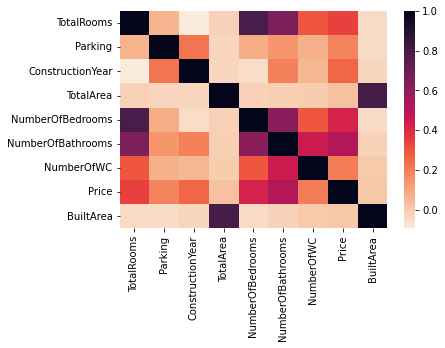

In [0]:
sns.heatmap(
    corr_matrix,
    cmap=sns.cm.rocket_r,
    xticklabels=df_corr.columns,
    yticklabels=df_corr.columns,
)

plt.show()

In [0]:
for i in range(len(num_cols)):
    for j in range(i + 1, len(num_cols)):
        corr_value = corr_matrix[i][j]
        if corr_value >= 0.5:
            print(f"{num_cols[i]}, {num_cols[j]} -> {corr_value}")

TotalRooms, NumberOfBedrooms -> 0.7883052781698379
TotalRooms, NumberOfBathrooms -> 0.65073464825634
TotalArea, BuiltArea -> 0.7984178194589449
NumberOfBedrooms, NumberOfBathrooms -> 0.6173324558957641
NumberOfBathrooms, Price -> 0.517798114169035


After analysing the correlation matrix, it is noticeable that NumberOfBathrooms is a bit correlated with the target but not highly correlated, so we will consider that there is no highly correlation between any variable and the target. We will also not remove any variables, as despite having some variables with somewhat significant correlations, we believe that given the fact that they aren't exactly identical, we shouldn't remove them when the analysis is only performed with such a small data sample.


## Handling Missing Values

Checking the percentage of missing values per column to decide what we should do. 

In [0]:
# Checking missing values percentage per column
nrows = pt_housing.count()

n_missing = pt_housing.select(
    [count(when(col(c).isNull(), c)).alias(c) for c in pt_housing.columns]
)
# For each column we count the number of nulls, we use the alias to have a good display

print("Number of missing values per column: ")
display(n_missing)
print("Percentage of missing values per column: ")
display(
    n_missing.select([((col(c) / nrows) * 100).alias(c) for c in n_missing.columns])
)  # Percentage

Number of missing values per column: 


Price,District,City,Town,Type,EnergyCertificate,Floor,Lift,Parking,HasParking,ConstructionYear,TotalArea,GrossArea,PublishDate,Garage,Elevator,ElectricCarsCharging,TotalRooms,NumberOfBedrooms,NumberOfWC,ConservationStatus,LivingArea,LotSize,BuiltArea,NumberOfBathrooms
242,0,0,0,0,0,0,45662,194,45662,40501,6446,86063,97983,51463,51463,51463,24372,56376,54724,0,27089,84630,95005,1792


Percentage of missing values per column: 


Price,District,City,Town,Type,EnergyCertificate,Floor,Lift,Parking,HasParking,ConstructionYear,TotalArea,GrossArea,PublishDate,Garage,Elevator,ElectricCarsCharging,TotalRooms,NumberOfBedrooms,NumberOfWC,ConservationStatus,LivingArea,LotSize,BuiltArea,NumberOfBathrooms
0.21438695960311838,0.0,0.0,0.0,0.0,0.0,0.0,40.45180722891566,0.17186392629340894,40.45180722891566,35.87969525159461,5.710489014883062,76.24291282778172,86.80279943302622,45.590892983699504,45.590892983699504,45.590892983699504,21.59107016300496,49.94330262225372,48.479801559177886,0.0,23.99805102763997,74.97342310418144,84.16459957476967,1.5875265768958184


We decided to drop City and Town because there are too many unique values and to also drop columns with more than 50% of missing values as it doesnt make sense to impute them.
We also droped Elevator, HasParking and NumberOfWC because we have other variables that represent this information and have less missing values and in this way we don't have redundant information.

In [0]:
# Dropping columns
pt_housing = pt_housing.drop(
    "Floor",
    "GrossArea",
    "PublishDate",
    "NumberOfBedrooms",
    "ConservationStatus",
    "LotSize",
    "BuiltArea",
    "Elevator",
    "HasParking",
    "NumberOfWC",
    "Town",
    "City",
)

# Dropping rows that have NaN values in Price
pt_housing = pt_housing.na.drop(how="any", subset="Price")

We still had some variables with missing values but we didnt want to drop them, so we checked the percentage of missing values per row.

In [0]:
# Checking percentage of missing values per row
ncols = len(pt_housing.columns)

missing_in_rows = pt_housing.withColumn(
    "nulls_row",
    f.expr(" + ".join([f"IF({c} IS NULL, 1, 0)" for c in pt_housing.columns])),
)  # Count the number of misssing per row

missing_in_rows = missing_in_rows.withColumn(
    "nulls_percentage", (f.col("nulls_row") / ncols) * 100
)  # Here percentage

# Show only the rows that have more than 50% of missing values
display(
    missing_in_rows.filter(f.col("nulls_percentage") > 50)
)  # Show the ones with higher then 50%

Price,District,Type,EnergyCertificate,Lift,Parking,ConstructionYear,TotalArea,Garage,ElectricCarsCharging,TotalRooms,LivingArea,NumberOfBathrooms,nulls_row,nulls_percentage
89000.0,Braga,Storage,NC,false,0.0,null,null,null,null,null,null,null,7,53.84615384615385
19500.0,Aveiro,null,null,null,null,null,null,null,null,null,null,null,9,69.23076923076923
135000.0,Aveiro,null,null,null,null,null,null,null,null,null,null,null,9,69.23076923076923
330000.0,Aveiro,House,Not available,null,null,null,null,null,null,null,null,null,9,69.23076923076923
170000.0,Aveiro,null,null,null,null,null,null,null,null,null,null,null,9,69.23076923076923
60000.0,Aveiro,null,null,null,null,null,null,null,null,null,null,null,9,69.23076923076923
180000.0,Aveiro,null,null,null,null,null,null,null,null,null,null,null,9,69.23076923076923
79500.0,Aveiro,null,null,null,null,null,null,null,null,null,null,null,9,69.23076923076923
190000.0,Aveiro,null,null,null,null,null,null,null,null,null,null,null,9,69.23076923076923
69000.0,Aveiro,null,null,null,null,null,null,null,null,null,null,null,9,69.23076923076923


In [0]:
# Percentage of rows with more than 50% of missing values
display(
    (
        ((missing_in_rows.filter(f.col("nulls_percentage") >= 50)).count())
        / (pt_housing.count())
    )
    * 100
)

0.022194996360020595

Only 0.02% of our rows have more than 50% of missing values, so we decided to filter them out.

In [0]:
# Filter our dataset by the rows that have less than 50% of missing values
pt_housing = missing_in_rows.filter(f.col("nulls_percentage") < 50)

We filtered the dataset to only keep the rows that have less than 50% of missing values


In [0]:
# Drop variables that were creating only for missing values analysis
pt_housing = pt_housing.drop("nulls_percentage", "nulls_row").cache()

## Imputation

- Town - dropped.
- Lift - assumed values.
- HasParking - dropped (Redundant with Parking).
- Garage - assumed values.
- ElectricCarsCharging - assumed values.
- Total Rooms - conditions based on type.
- NumberOfWC - dropped.
- LivingArea - assumed values.
- Number of Bathrooms - imputed.
- Type - imputed.
- Parking - imputed.
- ConstructionYear - imputed.
- TotalArea - imputed.

Firstly we changed boolean variables to 0 and 1, so it was easier to work with them in case we needed to impute them.

In [0]:
# converting columns with True/False to 1/0
def BtoInt(val):
    if val == True:
        return 1
    elif val == False:
        return 0
    elif val == None:
        return None


udf_BtoInt = f.udf(lambda x: BtoInt(x), IntegerType())
# We pass each value of boolean to integer with the specific columns , this is like a map

cols_to_transform = ["Lift", "Garage", "ElectricCarsCharging"]

for c in cols_to_transform:
    pt_housing = pt_housing.withColumn(c, udf_BtoInt(pt_housing[c]))

After analysing the missing values in the following variables: 
- Lift.
- Garage.
- ElectricCarsCharging.
- LivingArea.

We noticed that most missing values meant that that variable wasn't applied in that case, which means, it was 0. 

In [0]:
# Filling null values with 0
pt_housing = pt_housing.na.fill(
    value=0, subset=["Lift", "Garage", "ElectricCarsCharging", "LivingArea"]
)

We also analysed the missing values in the TotalRooms variable and noticed that the some of them were related to the Type of the property. In most cases, there were null values when the Type of property was Land, which makes sense, so we decided to put those null values as 0.

In [0]:
# Filling null values in Total Rooms based on Type of Property
# Only for Land, the rest will be imputed
pt_housing = pt_housing.withColumn(
    "TotalRooms",
    when((f.col("Type") == "Land") & (f.col("TotalRooms")).isNull(), 0).otherwise(
        f.col("TotalRooms")
    ),
).cache()

- Type - impute.
- Parking - impute.
- ConstructionYear - impute.
- TotalArea - impute.
- TotalRooms - impute.
- Number of Bathrooms - impute.

In [0]:
# Convert string columns to numerical form
# String indexer converts categorical to a unique value as integer
indexer = StringIndexer(
    inputCols=["District", "EnergyCertificate", "Type"],
    outputCols=[c + "_index" for c in ["District", "EnergyCertificate", "Type"]],
    handleInvalid="skip",
)
pt_housing_ind = indexer.fit(pt_housing).transform(pt_housing)
pt_housing = pt_housing_ind.drop("District", "EnergyCertificate", "Type")

  We decided to create an id to be able to join the imputed dataset with the original one.

In [0]:
pt_housing = pt_housing.select("*").withColumn("id", monotonically_increasing_id())

We splited the data, with 70% for train and 30% for test.

In [0]:
train, test = pt_housing.randomSplit([0.7, 0.3], seed=42)

We cache the train and test. Because we will use them many times afterwards, and caching will allow us to run faster as we wont be reading the dataset all the time.

In [0]:
train = train.cache()
test = test.cache()

We delete **pt_housing** from the python environment and the databricks environment because it will not be used anymore, and we will free up some space.

In [0]:
pt_housing.unpersist()
del pt_housing

We decided to create a function for imputation, as many of our features will need imputation.

The function works as following:

1. Make a copy of the list with the variables to impute.

2. If the variable we choose to impute is in the list of variables to impute, we remove it from that list so that we only use the other variables to impute the choosen one.

3. Divide the data into train and missing:
 - **train**: only has the rows without null values on the specified variable;
 - **missing**: has the rows with null values on the specified variable.

4. Choose the columns to use in the imputation. We will choose all columns that aren't the specified variable, 'Price' which will be our target, 'id' because this variable won't help in the imputation and the variables that are in the list to impute.

5. Then we create a VectorAssembler to put together all the choosen variables in a vector, so that we can pass these variables in a RandomForestRegressor.

6. We create a pipeline with our assembler and the random forest so that we can have both steps in a single one. Then we fit to our **train**, so the model can learn only with the not null rows and then get our imputations by doing **predictions = model.transform(missing)** and finally change the name of the column with the imputations to the variable that was imputed.

7. In order to be able to get the imputed values in **missing** we needed to create a id for both **missing** and **prediction** and then joined them both.

8. To get our data altogether again, we joined the **train** and **missing** on the variable in common (the variable we just imputed) and sorted the rows in ascendent order.

9. Finally, we substitute the original column that was specified by the one that has no null values, in the original data.

10. We append the variable again to the list.

In [0]:
def impute(data, var, lt_imp):

    lt_imp = lt_imp.copy()
    if var in lt_imp:  # If the variable we specified is to impute we remove it
        lt_imp.remove(var)

    train = data.filter(
        col(var).isNotNull()
    )  # Our train is only not nulls, to avoid imputing nulls
    missing = data.filter(col(var).isNull())  # These are the rows to impute

    features_cols = [
        c
        for c in train.columns
        if c != var and c != "Price" and c != "id" and c not in lt_imp
    ]  # Select the columns for imputation
    features_col_name = f"features_{var}"

    # Creates a vector with the variables that will be used for imputation
    assembler = VectorAssembler(
        inputCols=features_cols, outputCol=features_col_name, handleInvalid="skip"
    )

    # Random Forest
    rf = RandomForestRegressor(featuresCol=features_col_name, labelCol=var)

    # Pipeline for the assembler and random forest to be easier
    pipeline = Pipeline(stages=[assembler, rf])

    model = pipeline.fit(train)
    predictions = model.transform(missing)
    predictions = predictions.select("prediction").withColumnRenamed(
        "prediction", var
    )  # We change the name from prediction to the variable

    missing = missing.withColumn("row_id", monotonically_increasing_id()).drop(
        var
    )  # Create an id for the missing dataframe
    predictions = predictions.withColumn(
        "row_id", monotonically_increasing_id()
    )  # Create an id for predictions

    missing = missing.join(predictions, on="row_id").drop(
        "row_id"
    )  # We join the missing on the predictions

    data = train.unionByName(missing).sort(
        asc("id")
    )  # We join the data without nulls and the data imputed and then sort by id in ascending order

    data = data.withColumn(
        var, data[var].cast("int")
    )  # We create a new column in the final data for the imputed column and force it to be int

    lt_imp.append(
        var
    )  # We are append it to the list so it can be used to impute other variables

    return data


to_impute = [
    "Type_index",
    "Parking",
    "ConstructionYear",
    "TotalArea",
    "TotalRooms",
    "NumberOfBathrooms",
]

for c in to_impute:
    train = impute(train, c, to_impute)
    test = impute(test, c, to_impute)

In [0]:
# Drop the id because it wont be used anymore
train = train.drop("id")
test = test.drop("id")

## Model Training

In [0]:
ind_cols = [
    c for c in train.columns if c.endswith("_index")
]  # If the variable ends with _index that means it went trough the string indexer and therefore needs to be one hot encoded
cols = [
    "Lift",
    "Parking",
    "ConstructionYear",
    "TotalArea",
    "Garage",
    "ElectricCarsCharging",
    "TotalRooms",
    "LivingArea",
    "NumberOfBathrooms",
    "District_index_vec",
    "EnergyCertificate_index_vec",
    "Type_index_vec",
]

encoder = OneHotEncoder(inputCols=ind_cols, outputCols=[c + "_vec" for c in ind_cols])
assembler = VectorAssembler(inputCols=cols, outputCol="features")
scaler = StandardScaler(inputCol="features", outputCol="features_scaled")

pipeline_train = Pipeline(stages=[encoder, assembler, scaler])
model = pipeline_train.fit(train)
train = model.transform(train)
test = model.transform(test)

Here we save the dataframe so that if its needed we can only read the train and test and not apply all the previous steps again.

In [0]:
train.write.format("delta").mode("overwrite").save("/FileStore/tables/datalake/train")

In [0]:
test.write.format("delta").mode("overwrite").save("/FileStore/tables/datalake/test")

In [0]:
train = spark.read.format("delta").load("/FileStore/tables/datalake/train")

In [0]:
test = spark.read.format("delta").load("/FileStore/tables/datalake/test")

Defining the evaluator.


In [0]:
# Calculates the RMSE on our target and prediction
evaluator = RegressionEvaluator(
    metricName="rmse", labelCol="Price", predictionCol="prediction"
)

Here we will try different parameter searches to different parameters, and then use the obtained models of the searches to predict our target variable. Note that the gridsearches are relatively small for computational purposes, they are only present to show it's possible to gridsearch in pyspark.ml.

### Gradient Boost Trees

In [0]:
gbt = GBTRegressor(
    featuresCol="features_scaled", labelCol="Price"
)  # We initialize the model to be used in the Gridsearch
# Choose parameters first argument is the argument of the model and the second the values
gbt_param_grid = (
    ParamGridBuilder()
    .addGrid(gbt.maxDepth, [1, 5])
    .addGrid(gbt.stepSize, [0.1, 0.2])
    .build()
)

In [0]:
gbt_crossval = CrossValidator(
    estimator=gbt, estimatorParamMaps=gbt_param_grid, evaluator=evaluator, numFolds=10
)  # Cross Validation with the combinations

In [0]:
gbt_cv_model = gbt_crossval.fit(train)

In [0]:
# This is repeated for all models
gbt_best_model = gbt_cv_model.bestModel  # We get the best parameters
gbt_predictions = gbt_best_model.transform(test)  # Get the predictions
gbt_rmse = evaluator.evaluate(gbt_predictions)  # Evaluate
print(f"Gradient-Boosted Trees Best Model: {gbt_best_model}")
print(f"Gradient-Boosted Trees Test RMSE: {gbt_rmse}")
display(gbt_predictions.select("Price", "prediction"))

Gradient-Boosted Trees Best Model: GBTRegressionModel: uid=GBTRegressor_0ffe8b0f5452, numTrees=20, numFeatures=64
Gradient-Boosted Trees Test RMSE: 259765.17879956783


Price,prediction
175000.0,158257.14260558283
260000.0,200498.7231482949
100000.0,393715.82255406433
250000.0,417064.64188738214
2000000.0,684712.6484598641
595000.0,439784.92743535637
435000.0,259139.74167591005
185000.0,143127.36226232056
228000.0,423052.20550079923
250000.0,423052.20550079923


Databricks visualization. Run in Databricks to view.

### Random Forest

In [0]:
rf = RandomForestRegressor(featuresCol="features_scaled", labelCol="Price")

rf_param_grid = (
    ParamGridBuilder()
    .addGrid(rf.numTrees, [10, 20])
    .addGrid(rf.maxDepth, [5, 10])
    .build()
)

In [0]:
rf_crossval = CrossValidator(
    estimator=rf, estimatorParamMaps=rf_param_grid, evaluator=evaluator, numFolds=10
)

In [0]:
rf_cv_model = rf_crossval.fit(train)

In [0]:
rf_best_model = rf_cv_model.bestModel
rf_predictions = rf_best_model.transform(test)
rf_rmse = evaluator.evaluate(rf_predictions)
print(f"Random Forest Best Model: {rf_best_model}")
print(f"Random Forest Test RMSE: {rf_rmse}")
display(rf_predictions.select("Price", "prediction"))

Random Forest Best Model: RandomForestRegressionModel: uid=RandomForestRegressor_22d982f2c532, numTrees=20, numFeatures=64
Random Forest Test RMSE: 259689.65464988304


Price,prediction
175000.0,191365.64767803653
260000.0,233733.13323455723
100000.0,357697.6227341241
250000.0,341740.4747571788
2000000.0,924662.7026241139
595000.0,393284.43337215576
435000.0,318260.2518692381
185000.0,147078.4240267078
228000.0,395644.08808126225
250000.0,396864.0870884772


Databricks visualization. Run in Databricks to view.

### Linear Regression

In [0]:
lr = LinearRegression(featuresCol="features_scaled", labelCol="Price")

param_grid = (
    ParamGridBuilder()
    .addGrid(lr.regParam, [0.01, 0.1, 1.0])
    .addGrid(lr.elasticNetParam, [0.0, 0.5, 1.0])
    .build()
)

In [0]:
lr_crossval = CrossValidator(
    estimator=lr, estimatorParamMaps=param_grid, evaluator=evaluator, numFolds=10
)

In [0]:
lr_cv_model = lr_crossval.fit(train)

In [0]:
lr_best_model = lr_cv_model.bestModel
lr_predictions = lr_cv_model.transform(test)
lr_rmse = evaluator.evaluate(lr_predictions)
print(f"Linear Regression Best Model: {lr_best_model}")
print(f"Linear Regression Test RMSE: {lr_rmse}")
display(lr_predictions.select("Price", "prediction"))

Linear Regression Best Model: LinearRegressionModel: uid=LinearRegression_16b4988cca6e, numFeatures=64
Linear Regression Test RMSE: 301373.39516581607


Price,prediction
175000.0,398428.4185873496
260000.0,320679.715621121
100000.0,302742.18247836665
250000.0,357909.97078214283
2000000.0,592435.9037676889
595000.0,515550.5359345658
435000.0,455713.9646073554
185000.0,216455.21709460462
228000.0,486640.12729933835
250000.0,487702.98958575097


Databricks visualization. Run in Databricks to view.

In this part we re-read the data and apply it to the NeuralNetwork we defined.

### Neural Networks

In [0]:
train = spark.read.format("delta").load("/FileStore/tables/datalake/train")
test = spark.read.format("delta").load("/FileStore/tables/datalake/test")

In [0]:
class Model(nn.Module):
    def __init__(self, input_dim):
        super(Model, self).__init__()
        # Create "Dense" layers , the first parameter is the input shape and the second the number of neurons
        self.layer1 = nn.Linear(input_dim, 50)
        self.layer2 = nn.Linear(50, 50)
        self.layer3 = nn.Linear(50, 1)

        # Choose the activation function of the layers

    def forward(self, x):
        x = F.relu(self.layer1(x))
        x = F.relu(self.layer2(x))
        x = self.layer3(
            x
        )  # This one doesn't need activation because its a regression problem
        return x


# Make the model itself
input_dim = 64  # is in features_scaled
model = Model(input_dim=input_dim)
optimizer = torch.optim.Adam(
    model.parameters(), lr=0.001
)  # Optimizer with the learning rate
loss_fn = nn.MSELoss()  # Initialize the loss

# Transforming features_scaled into a tensor
# RDD is used for to access values of df and to use RDD operations in it
# Map is to ensure rdd only contains columns vectors and not the structure
# Collect is to transform into a list of lists
X_train = torch.tensor(
    train.select("features_scaled").rdd.map(lambda row: row).collect(),
    dtype=torch.float32,
)
X_test = torch.tensor(
    test.select("features_scaled").rdd.map(lambda row: row).collect(),
    dtype=torch.float32,
)
# Transforming Price into a tensor
# RDD is used for to access values of df and to use RDD operations in it
# Map is to ensure RDD only contains columns vectors and not the structure
# Collect is to transform into a list of lists
# Unsqueeze to put our shape as 2D
y_train = torch.tensor(
    train.select("Price").rdd.map(lambda row: row).collect(), dtype=torch.float32
).unsqueeze(1)
y_test = torch.tensor(
    test.select("Price").rdd.map(lambda row: row).collect(), dtype=torch.float32
).unsqueeze(1)

n_epochs = 50
# Train the model
for epoch in range(n_epochs):
    model.train()

    y_pred = model(X_train)

    loss_value = loss_fn(y_pred, y_train)

    # Backpropagation
    optimizer.zero_grad()  # Zero out the gradient, otherwise the gradient would be a combination of the old one
    loss_value.backward()  # Backward the loss
    optimizer.step()

    if epoch % 10 == 0:
        print(f"Epoch [{epoch}/{n_epochs}], Loss: {loss_value.item()}")

model.eval()
y_pred = model(X_test)
loss_value = loss_fn(y_pred, y_test)
print(f"Neural Network Test MSE: {loss_value.item()}")
print(f"Neural Network Test RMSE: {loss_value.item()**0.5}")

Epoch [0/50], Loss: 254603821056.0
Epoch [10/50], Loss: 254602493952.0
Epoch [20/50], Loss: 254600740864.0
Epoch [30/50], Loss: 254597627904.0
Epoch [40/50], Loss: 254592106496.0
Neural Network Test MSE: 260166156288.0
Neural Network Test RMSE: 510064.8549821875


We could conclude that our best model was the Random Forest, as it only fails the real price by 259 689 euros, on average. 

The second best model was the Gradient Boosted Trees, with an error of 259 765 euros, on average. 

The third the best model was the Linear Regression with a difference between the real price and our predictions of 301373 euros, on average.

Lastly the Neural Network had an average error of 510 064 euros.

According to literature usually the Linear Regression is the one that should perform better in house price prediction. However as we are not regarding economic factors this was not true in our implementation.
 
This notebook is also proof that depending on the problem and data simpler algorithms can outperform complex ones.
We want also to note that the Gradient Boosted Trees, and the Linear Regression predict negative values for the property prices.

## References:
- https://www.kaggle.com/datasets/luvathoms/portugal-real-estate-2024?resource=download
- https://spark.apache.org/docs/latest/ml-classification-regression.html#linear-regression
- https://stackoverflow.com/questions/43406887/spark-dataframe-how-to-add-a-index-column-aka-distributed-data-index
- https://spark.apache.org/docs/latest/api/python/reference/api/pyspark.ml.tuning.CrossValidator.html
- https://spark.apache.org/docs/latest/api/python/reference/api/pyspark.ml.tuning.ParamGridBuilder.html
- https://medium.com/@aryaman0171/train-deep-learning-models-with-big-data-using-pyspark-3d05dd687f0c
- https://github.com/dhruv-pandit/big-data-labsIMS/tree/main/notebooks
- Mao, Tingjun. (2023). Real Estate Price Prediction Based on Linear Regression and Machine Learning Scenarios. BCP Business & Management. 38. 400-409. 10.54691/bcpbm.v38i.3720. 
